In [ ]:
# from google.colab import drive
# drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
# path_to_pretraining_dataset = '/content/drive/MyDrive/uni/Project/data/pretraining_dataset_50k.zip'
# # path_to_finetuning_dataset = '/content/drive/MyDrive/uni/Project/data/finetuning_dataset.zip'
# path_to_finetuning_dataset = '/content/drive/MyDrive/uni/Project/data/mario.zip'
# # Change this to the path where you want to extract the files
# extraction_path = '/content/'




# # Command to unzip the file
# !unzip -uq "$path_to_pretraining_dataset" -d "$extraction_path"
# !unzip -uq "$path_to_finetuning_dataset" -d "$extraction_path"

In [ ]:
# !pip install -q miditok pretty_midi
# # !pip install -U flash-attn --no-build-isolation
# !pip install -q bitsandbytes
# !pip install -q accelerate
# !pip install -q torcheval

In [2]:
from miditok import REMI
# import miditok
import torch

from transformers import AutoModelForCausalLM, GenerationConfig, BitsAndBytesConfig
from tqdm import tqdm
import glob
import numpy as np
from pathlib import Path
from matplotlib import pyplot as plt
import pandas as pd

import IPython.display as ipd
import pretty_midi
import os
import random

def play_midi(midi_path, sr=22050): # notebook only
    if str(type(midi_path)) == "<class 'symusic.core.ScoreTick'>":
        holder_path = "holder.mid"
        midi_path.dump_midi(holder_path)
        midi_path=holder_path
    fn = os.path.join(midi_path)
    midi_data = pretty_midi.PrettyMIDI(fn)

    audio_data = midi_data.synthesize(fs=sr)
    return ipd.Audio(audio_data, rate=sr)

def make_piano_roll(song, title="Piano Roll"): ## prettyMIDI as input
    if str(type(song)) == "<class 'symusic.core.ScoreTick'>":
        holder_path = "holder.mid"
        song.dump_midi(holder_path)
        song=holder_path
        fn = os.path.join(song)
        song = pretty_midi.PrettyMIDI(fn)
    elif type(song) == str:
        song = pretty_midi.PrettyMIDI(song)
    piano_roll = song.get_piano_roll()

    plt.figure(figsize=(10, 5))
    plt.imshow(piano_roll, aspect='auto', origin='upper',)
    x_axis = np.arange(0, len(piano_roll[0]), 60*song.resolution)
    plt.xticks(x_axis, [i/(song.resolution*12) for i in x_axis])
    plt.xlabel(f'Time (s), {round(len(piano_roll[0])/(song.resolution*12), 3)}')
    plt.ylabel('MIDI Note Number')
    plt.title('Piano Roll')
    # plt.colorbar(label='Note On/Off', ticks=[0, 1])
    plt.show()

def calculate_perplexity(sequence, model):
    log_prob_sum = 0
    sequence_length = len(sequence)

    context = []
    for item in sequence:

        prob = model(context, item)
        log_prob_sum += np.log(prob + 1e-10)
        context.append(item)
    avg_neg_log_prob = -log_prob_sum / sequence_length
    perplexity = np.exp(avg_neg_log_prob)
    return perplexity

def calculate_perplexity(model, ids):
    model.eval()
    input = torch.tensor([ids])
    if torch.cuda.is_available():
        input.cuda()
    with torch.no_grad():
        outputs = model(input, labels=input)
        loss = outputs[0]
    return torch.exp(loss).item()

In [ ]:
pretrained_model_name = "mistral_pretraining_6ksteps_22batch"
preprocessed_model_name = "preprocessed_finetuned"
finetuned_model_name = "finetuning_16.0epochs"

quantization_config = BitsAndBytesConfig(
        load_in_4bit=True,
        bnb_4bit_quant_type="nf4",
        bnb_4bit_compute_dtype=torch.float16,
)

# model = AutoModelForCausalLM.from_pretrained("theglassofwater/"+model_name, quantization_config=True, device_map="auto")
pretrained_model = AutoModelForCausalLM.from_pretrained("theglassofwater/"+pretrained_model_name)#  , quantization_config=quantization_config)# , torch_dtype=torch.float16, attn_implementation="flash_attention_2")

finetuned_model = AutoModelForCausalLM.from_pretrained("theglassofwater/"+finetuned_model_name)

preprocessed_model = AutoModelForCausalLM.from_pretrained("theglassofwater/"+preprocessed_model_name)

if torch.cuda.is_available():
    pretrained_model.to("cuda")
    finetuned_model.to("cuda")

tokenizer = REMI.from_pretrained("theglassofwater/remi_12500")

def generate_comparison_song(model, ids, max_length):
    model.eval()

    new_tokens = max_length - len(ids)

    input = torch.tensor([ids])
    # input = torch.tensor([[1,]]) # bar_none, position_0
    # input = ids

    generation_config = GenerationConfig(
        max_new_tokens=new_tokens,
        min_tokens=25,
        do_sample=True,
        temperature=0.9,
        pad_token_id=tokenizer.pad_token_id,
    )
    if torch.cuda.is_available():
        input = input.cuda()

    output = model.generate(input, generation_config=generation_config)
    return output[0]

In [ ]:
midi_files = list(Path("/content/drive/MyDrive/uni/Project/code/audio/").glob("**/*.mid"))
print(f"number of midi_files = {len(midi_files)}")


max_seq_len = 4096

pretraining_midi_files = list(Path("/content/pretraining_dataset_2/").glob("*.mid"))
random.Random(4).shuffle(pretraining_midi_files)

pretraining_dataset = miditok.pytorch_data.DatasetMIDI(   #### test unseen dataset
    files_paths=pretraining_midi_files[int(len(pretraining_midi_files)*0.95):],
    max_seq_len=max_seq_len+1,  # max_seq_len = start + seq_len + end
    tokenizer=tokenizer,
    bos_token_id=tokenizer["BOS_None"],
    eos_token_id=tokenizer["EOS_None"],
)


finetuning_midi_files = list(Path("/content/mario").glob("*.mid"))
random.Random(4).shuffle(finetuning_midi_files)

finetuning_dataset = miditok.pytorch_data.DatasetMIDI(   #### test unseen dataset
    files_paths=finetuning_midi_files[int(len(finetuning_midi_files)*0.95):],
    max_seq_len=max_seq_len+1,  # max_seq_len = start + seq_len + end
    tokenizer=tokenizer,
    bos_token_id=tokenizer["BOS_None"],
    eos_token_id=tokenizer["EOS_None"],
)

collator = miditok.pytorch_data.DataCollator(
    pad_token_id=tokenizer["PAD_None"],
    copy_inputs_as_labels=True,
)

print(f"length of pretraining dataset :{len(pretraining_dataset)} out of {len(pretraining_midi_files)}")
print(f"length of finetuning dataset :{len(finetuning_dataset)} out of {len(finetuning_midi_files)}")

number of midi_files = 1030
length of pretraining dataset :2500 out of 50000
length of finetuning dataset :35 out of 690


In [ ]:
len(finetuning_dataset[0]["input_ids"])

1277

Score(ttype=Tick, tpq=8, begin=0, end=744, tracks=1, notes=484, time_sig=1, key_sig=0, markers=0, lyrics=0)


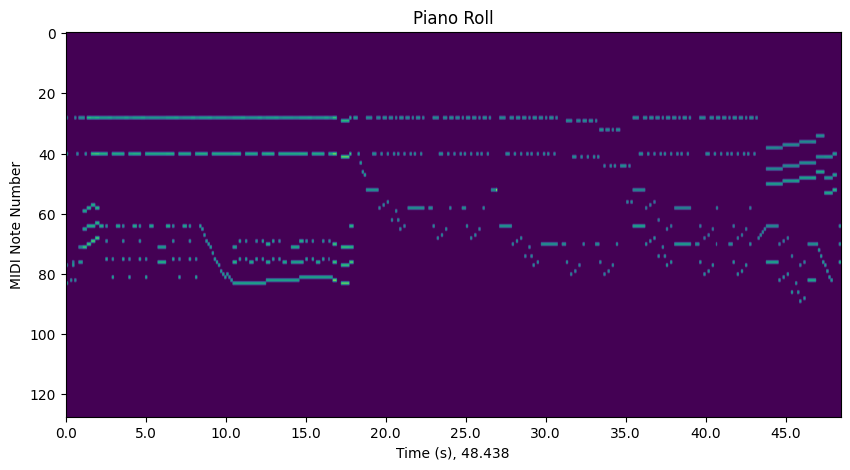

In [ ]:
x = 1024

tokenized_song_ids = finetuning_dataset[0]["input_ids"][:x]
tokenized_song = tokenizer(tokenized_song_ids)
print(tokenized_song)
make_piano_roll(tokenized_song)
play_midi(tokenized_song)

Score(ttype=Tick, tpq=8, begin=0, end=744, tracks=1, notes=484, time_sig=1, key_sig=0, markers=0, lyrics=0)


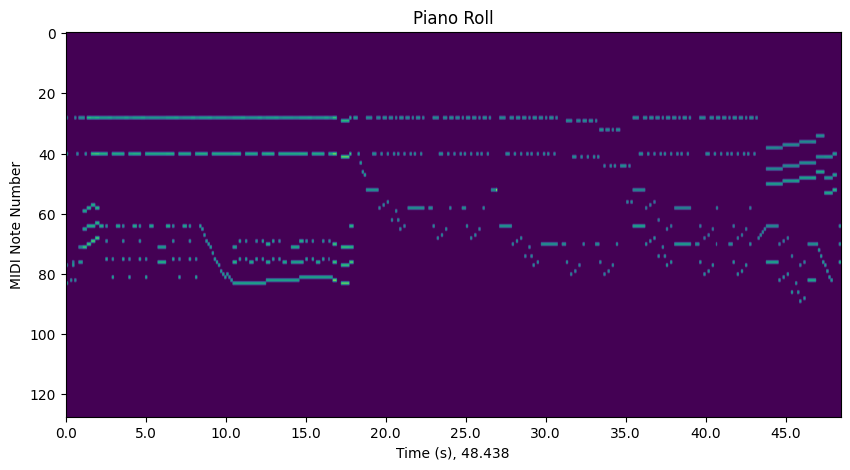

In [ ]:
##### SONGS FOR TESTING

# tokenized_song = tokenizer(midi_files[150]) #### choosing song, getting x amount of ids
# tokenized_song_ids = tokenized_song.ids[:1024]
tokenized_song_ids = finetuning_dataset[0]["input_ids"][:1024]
tokenized_song = tokenizer(tokenized_song_ids)
print(tokenized_song)
make_piano_roll(tokenized_song)
play_midi(tokenized_song)

Score(ttype=Tick, tpq=8, begin=0, end=958, tracks=1, notes=651, time_sig=1, key_sig=0, markers=0, lyrics=0)
374


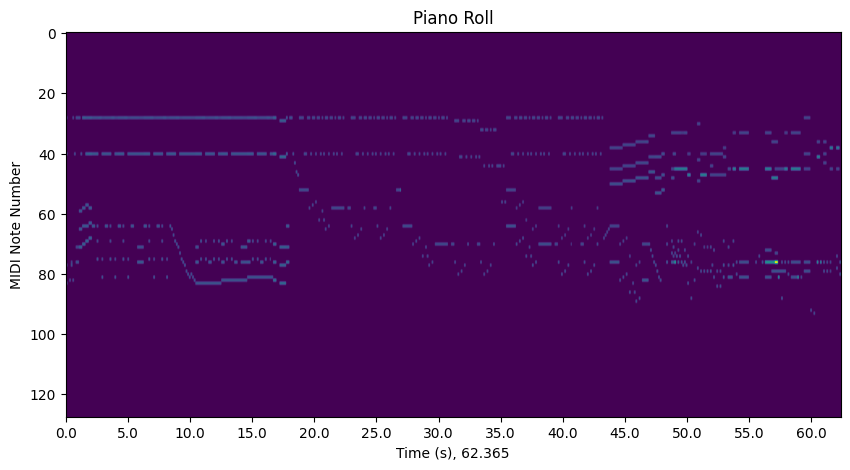

In [ ]:

output = generate_comparison_song(pretrained_model, list(tokenized_song_ids[:x]), x+350) # generating until x amount of ids

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)
print(1024-650)

make_piano_roll(output_song, "Pretrained Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=1026, tracks=1, notes=862, time_sig=1, key_sig=0, markers=0, lyrics=0)


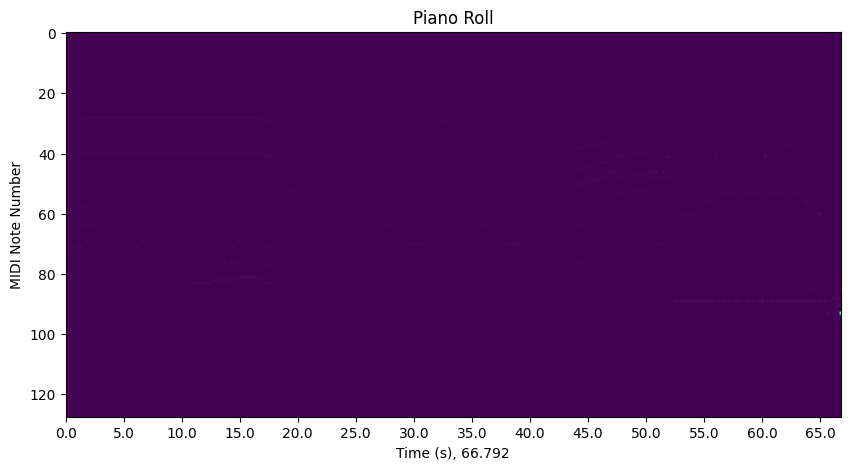

In [ ]:
output = generate_comparison_song(pretrained_model, list(tokenized_song_ids[:x]), x+1050)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=1528, tracks=11, notes=1322, time_sig=1, key_sig=0, markers=0, lyrics=0)


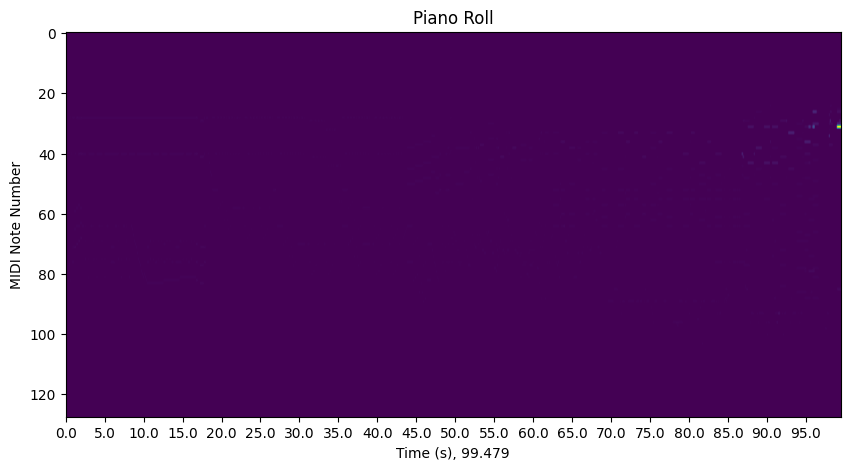

In [ ]:
output = generate_comparison_song(pretrained_model, list(tokenized_song_ids[:x]), x+1800)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=1088, tracks=3, notes=827, time_sig=1, key_sig=0, markers=0, lyrics=0)


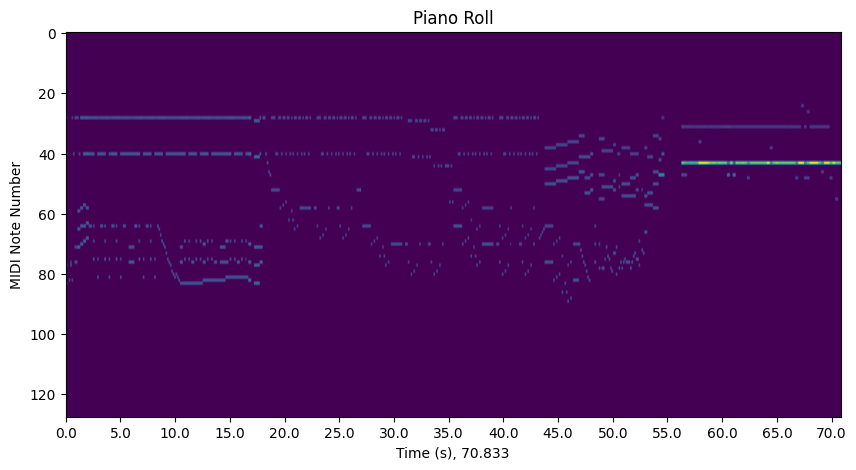

In [ ]:
# output = generate_comparison_song(finetuned_model, list(tokenized_song_ids[:650]), 1024) # generating until x amount of ids

output = generate_comparison_song(pretrained_model, list(tokenized_song_ids[:x]), x+700)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=1020, tracks=1, notes=822, time_sig=1, key_sig=0, markers=0, lyrics=0)


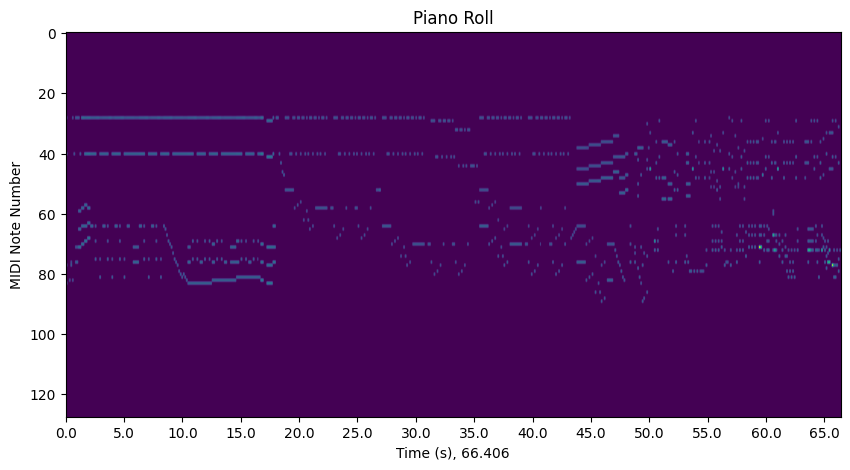

In [ ]:
output = generate_comparison_song(preprocessed_model, list(tokenized_song_ids[:x]), x+700)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=1112, tracks=2, notes=803, time_sig=1, key_sig=0, markers=0, lyrics=0)


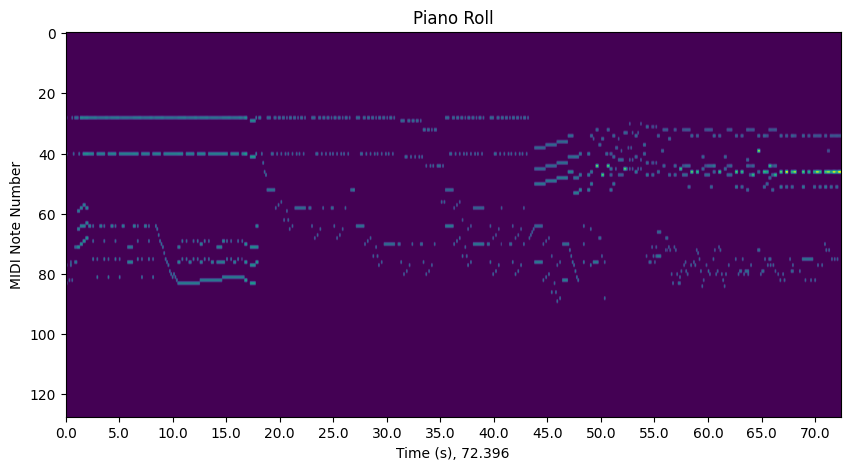

In [ ]:
output = generate_comparison_song(finetuned_model, list(tokenized_song_ids[:x]), x+700)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=156, tracks=3, notes=67, time_sig=1, key_sig=0, markers=0, lyrics=0)


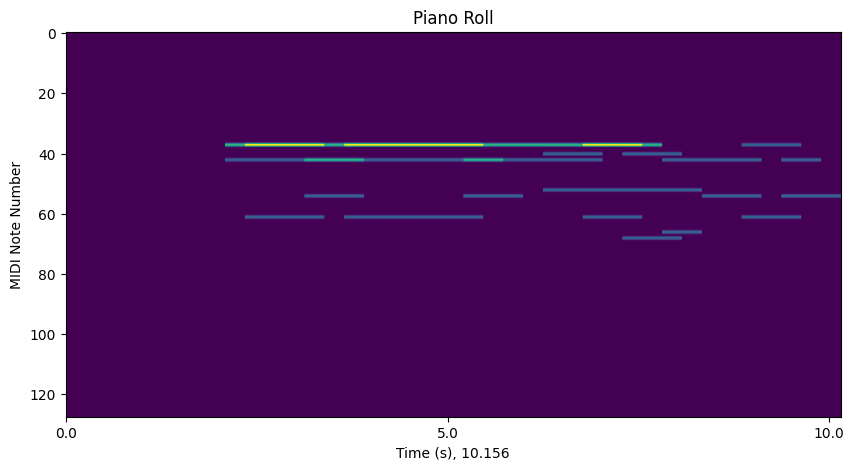

In [ ]:
output = generate_comparison_song(pretrained_model, [1,], 150)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=396, tracks=1, notes=37, time_sig=1, key_sig=0, markers=0, lyrics=0)


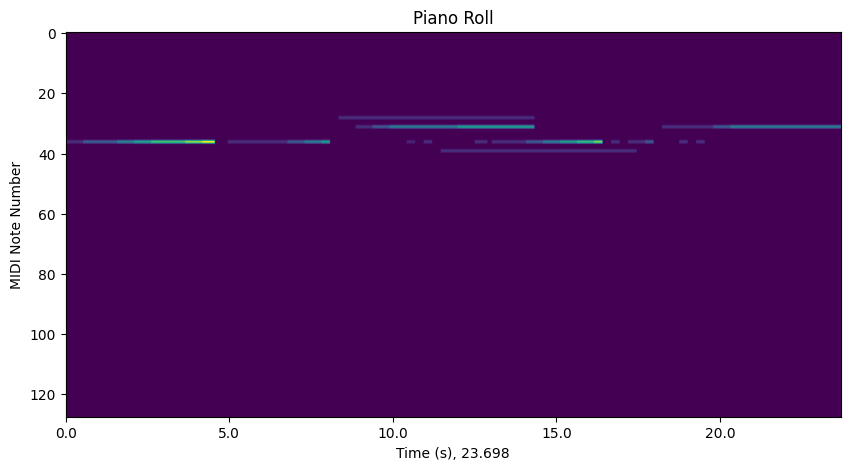

In [ ]:
output = generate_comparison_song(preprocessed_model,[1,], 150)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=115, tracks=1, notes=65, time_sig=1, key_sig=0, markers=0, lyrics=0)


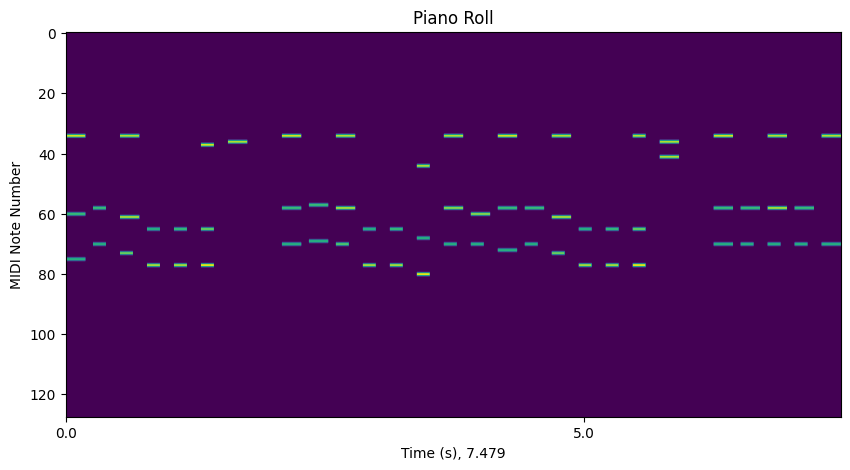

In [ ]:
output = generate_comparison_song(finetuned_model,[1,], 150)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=324, tracks=6, notes=240, time_sig=1, key_sig=0, markers=0, lyrics=0)


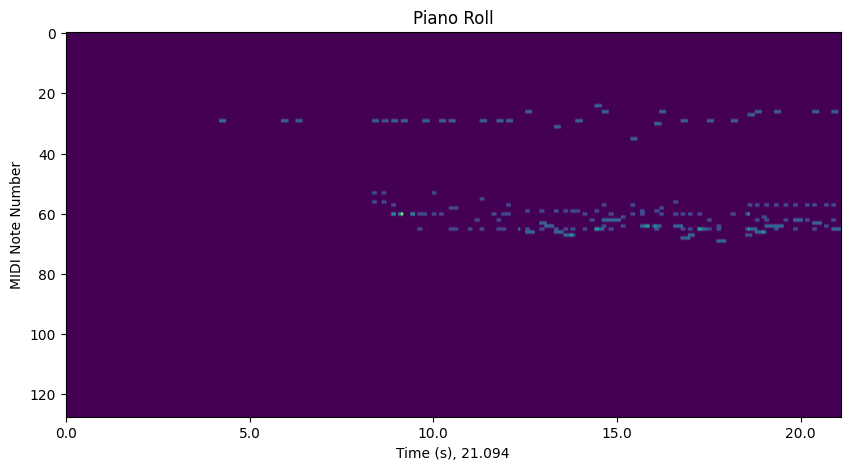

In [ ]:
output = generate_comparison_song(pretrained_model, [1,], 450)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=968, tracks=1, notes=193, time_sig=1, key_sig=0, markers=0, lyrics=0)


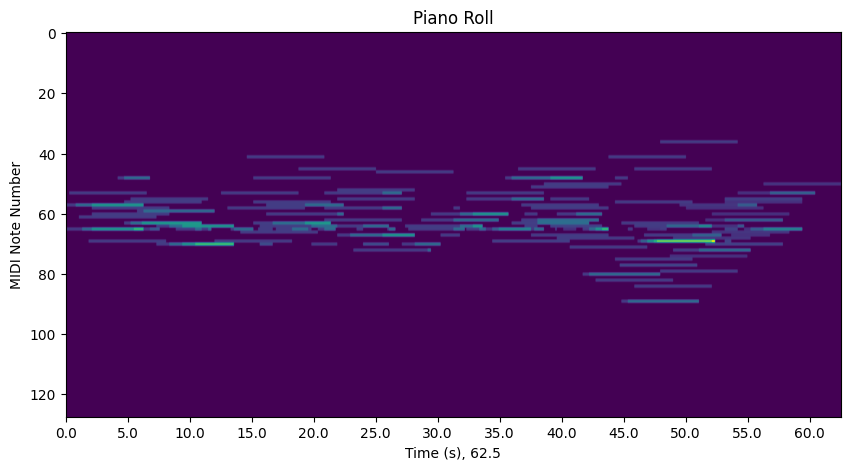

In [ ]:
output = generate_comparison_song(preprocessed_model,[1,], 450)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

Score(ttype=Tick, tpq=8, begin=0, end=152, tracks=2, notes=223, time_sig=1, key_sig=0, markers=0, lyrics=0)


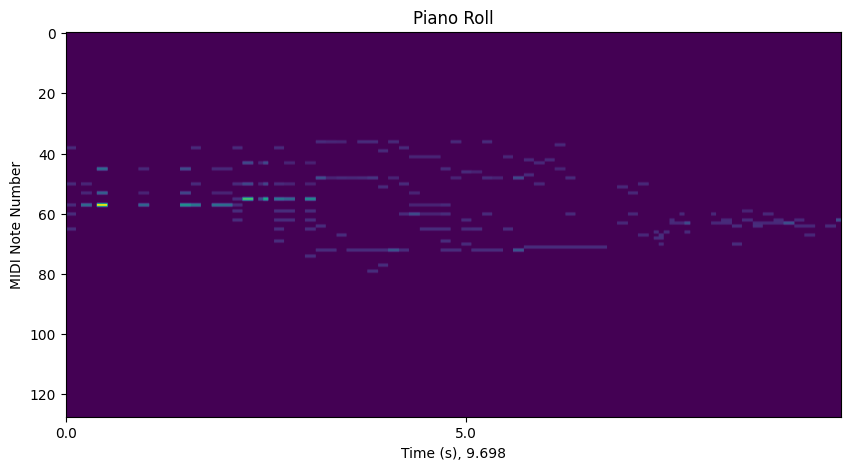

In [ ]:
output = generate_comparison_song(finetuned_model,[1,], 450)

output_song = tokenizer(output) # outputting the generated song
file_name = "model_output.mid"
output_song.dump_midi(file_name)
print(output_song)

make_piano_roll(output_song, "Finetuned Piano Roll")
play_midi(file_name)

In [ ]:
from torcheval.metrics.text import Perplexity

metric=Perplexity()

input_ids = pretraining_dataset[0]["input_ids"]
with torch.no_grad():
    outputs = pretrained_model(torch.tensor([[torch.tensor(i)for i in input_ids]]), labels=torch.tensor([[torch.tensor(i)for i in input_ids]]))
    neg_log_likelihood = outputs.loss

metric.update(input_ids, outputs[1][0])
metric.compute()

In [ ]:
metric.update(torch.tensor(torch.Tensor([i]) for i in outputs[1][0]), torch.tensor([[torch.tensor(i)] for i in input_ids]))
metric.compute()

In [ ]:
torch.tensor(outputs[1][0])

<ipython-input-105-d2c8f0f7bf97>:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  torch.tensor(outputs[1][0])


tensor([[-1.3163, -1.0796,  6.4669,  ..., -0.9118, -0.4337, -1.6179],
        [-0.6712, -0.7787,  7.2343,  ..., -0.6991,  0.0863, -1.1647],
        [-0.9714, -1.2588,  6.5671,  ..., -0.9252, -0.1580, -1.4154],
        ...,
        [-2.1127, -2.1362, -5.2561,  ..., -1.4607, -2.1803, -1.6464],
        [-4.2879, -4.6360, -0.1451,  ..., -4.1951, -4.0180, -3.8133],
        [-1.9630, -2.1769, -5.0181,  ..., -1.3863, -1.9228, -1.4714]])

In [ ]:
outputs[1][0]

tensor([[-1.3163, -1.0796,  6.4669,  ..., -0.9118, -0.4337, -1.6179],
        [-0.6712, -0.7787,  7.2343,  ..., -0.6991,  0.0863, -1.1647],
        [-0.9714, -1.2588,  6.5671,  ..., -0.9252, -0.1580, -1.4154],
        ...,
        [-2.1127, -2.1362, -5.2561,  ..., -1.4607, -2.1803, -1.6464],
        [-4.2879, -4.6360, -0.1451,  ..., -4.1951, -4.0180, -3.8133],
        [-1.9630, -2.1769, -5.0181,  ..., -1.3863, -1.9228, -1.4714]])

In [ ]:
input = torch.tensor([[[0.3659, 0.7025, 0.3104]], [[0.0097, 0.6577, 0.1947]],[[0.5659, 0.0025, 0.0104]], [[0.9097, 0.0577, 0.7947]]])
>>> target = torch.tensor([[2],  [1], [2],  [1]])
>>> metric.update(input, target)
>>> metric.compute()

tensor(3.5257, dtype=torch.float64)

In [ ]:
outputs[1][0]

tensor([[-1.3163, -1.0796,  6.4669,  ..., -0.9118, -0.4337, -1.6179],
        [-0.6712, -0.7787,  7.2343,  ..., -0.6991,  0.0863, -1.1647],
        [-0.9714, -1.2588,  6.5671,  ..., -0.9252, -0.1580, -1.4154],
        ...,
        [-2.1127, -2.1362, -5.2561,  ..., -1.4607, -2.1803, -1.6464],
        [-4.2879, -4.6360, -0.1451,  ..., -4.1951, -4.0180, -3.8133],
        [-1.9630, -2.1769, -5.0181,  ..., -1.3863, -1.9228, -1.4714]])

In [ ]:
###### Perplexity
import torch
from tqdm import tqdm

max_length = 24 # model.config.n_positions
stride = 512
seq_len = 4096 # encodings.input_ids.size(1)

input_ids = pretraining_dataset[0]["input_ids"]
print(len(input_ids))

nlls = []
prev_end_loc = 0
for begin_loc in tqdm(range(0, seq_len, stride)):
    end_loc = min(begin_loc + max_length, seq_len)
    trg_len = end_loc - prev_end_loc  # may be different from stride on last loop
    input_ids = input_ids[:, begin_loc:end_loc].to(device)
    target_ids = input_ids.clone()
    target_ids[:, :-trg_len] = -100

    with torch.no_grad():
        outputs = model(input_ids, labels=target_ids)

        # loss is calculated using CrossEntropyLoss which averages over valid labels
        # N.B. the model only calculates loss over trg_len - 1 labels, because it internally shifts the labels
        # to the left by 1.
        neg_log_likelihood = outputs.loss

    nlls.append(neg_log_likelihood)

    prev_end_loc = end_loc
    if end_loc == seq_len:
        break

ppl = torch.exp(torch.stack(nlls).mean())



ids = tokenized_song_ids[:500]
perplexity = calculate_perplexity(pretrained_model, list(ids))
print(f'Perplexity of the sample: {perplexity}')

4096


  0%|          | 0/8 [00:00<?, ?it/s]


IndexError: too many indices for tensor of dimension 1